In [2]:
!git clone https://github.com/fruits-360/fruits-360-original-size.git


Cloning into 'fruits-360-original-size'...
remote: Enumerating objects: 12542, done.
remote: Counting objects: 100% (12/12), done.
remote: Compressing objects: 100% (12/12), done.
remote: Total 12542 (delta 1), reused 8 (delta 0), pack-reused 12530 (from 1)
Receiving objects: 100% (12542/12542), 549.61 MiB | 28.25 MiB/s, done.
Resolving deltas: 100% (1/1), done.
Updating files: 100% (12457/12457), done.


In [3]:
cd fruits-360-original-size


/content/fruits-360-original-size


In [4]:
ls

LICENSE  README.md  Test/  Training/  Validation/


In [5]:
pwd


'/content/fruits-360-original-size'

In [6]:
import os

# Path to the training folder
train_folder = '/content/fruits-360-original-size/Training'

# List the subfolders (fruit classes) in the training folder
fruit_classes = os.listdir(train_folder)
print(fruit_classes[:62])  # Display first 10 classes


['apple_6', 'apple_pink_lady_1', 'pear_1', 'carrot_1', 'apple_golden_2', 'zucchini_dark_1', 'apple_red_yellow_1', 'apple_rotten_1', 'apple_golden_1', 'apple_red_2', 'cucumber_1', 'eggplant_long_1', 'cucumber_3', 'apple_hit_1', 'zucchini_1', 'apple_braeburn_1', 'apple_golden_3', 'apple_red_delicios_1', 'cabbage_white_1', 'apple_red_1', 'apple_red_3', 'pear_3', 'apple_crimson_snow_1', 'apple_granny_smith_1']


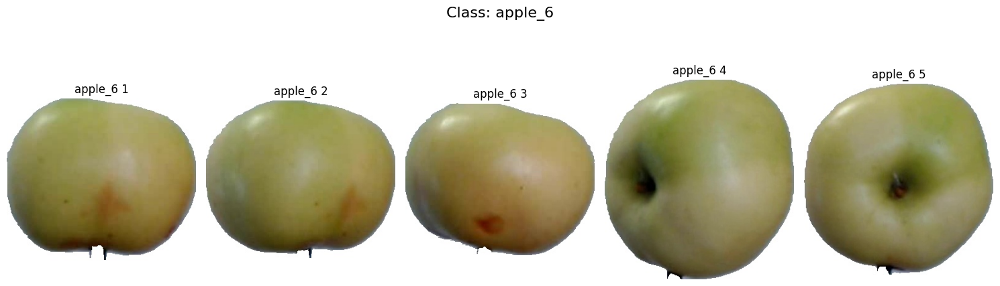

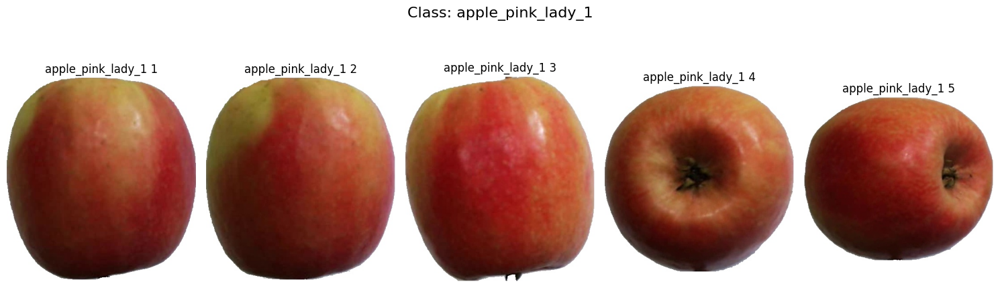

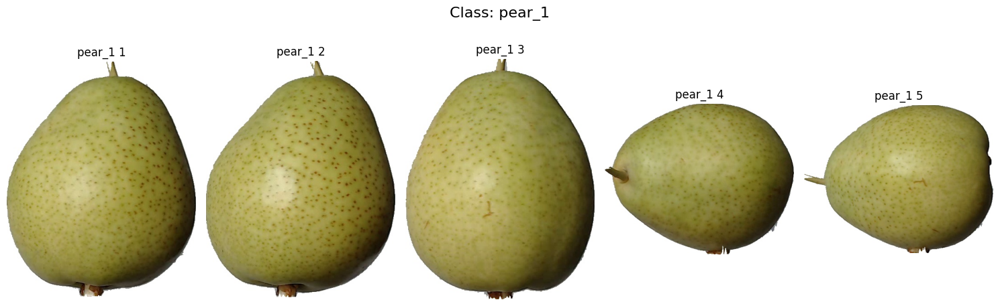

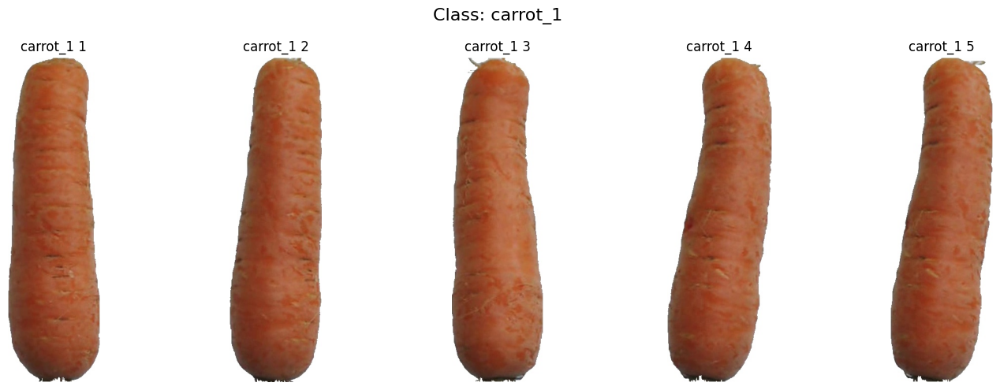

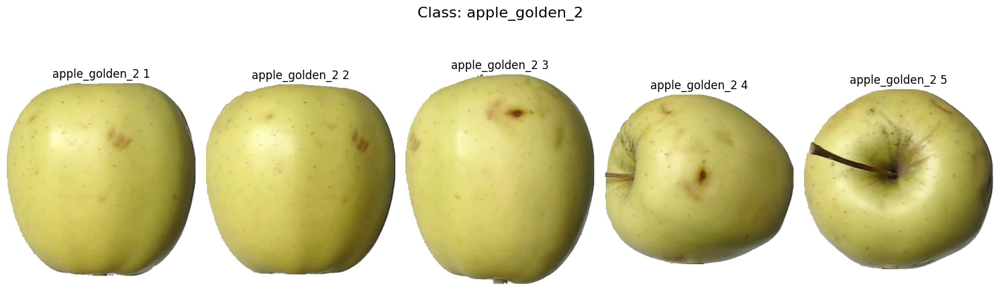

...

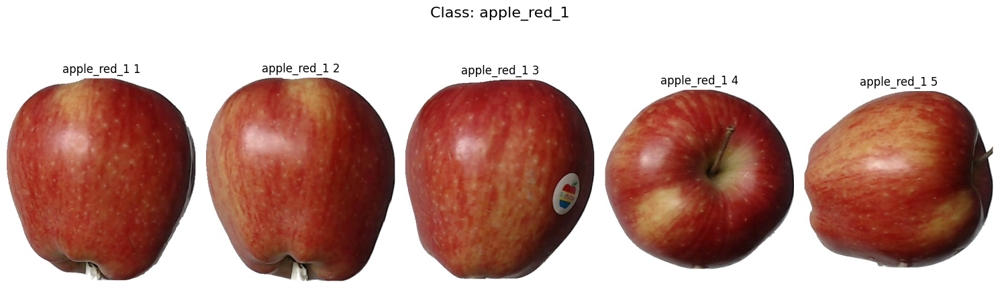

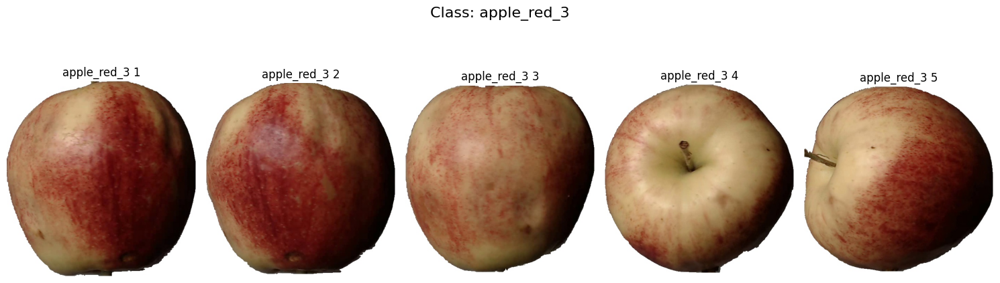

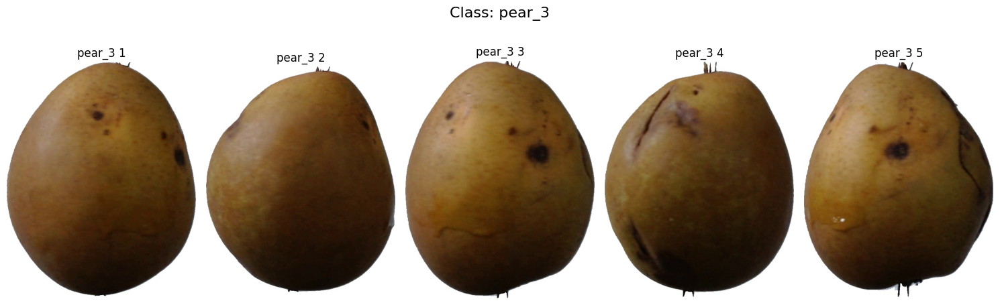

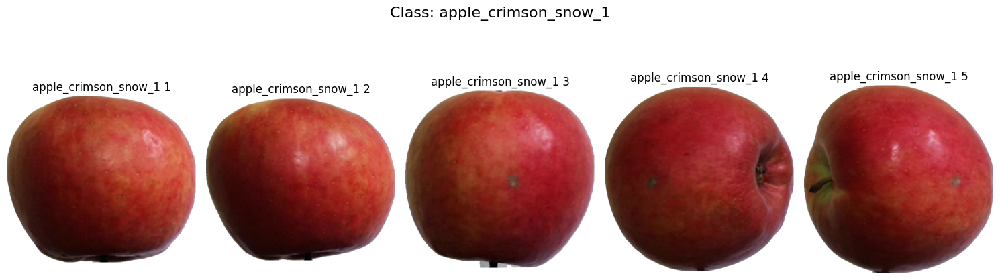

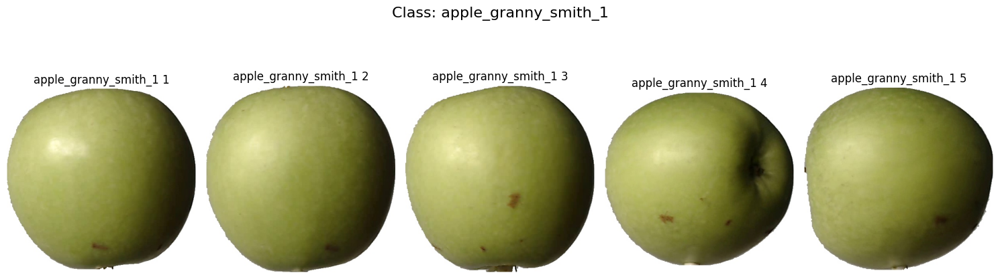

In [12]:
import os
from PIL import Image
import matplotlib.pyplot as plt

# Path to the Training folder
training_folder = '/content/fruits-360-original-size/Training'

# List all class folders in the Training directory
class_folders = [f for f in os.listdir(training_folder) if os.path.isdir(os.path.join(training_folder, f))]

# Display a few images from each class
for class_folder in class_folders:
    class_path = os.path.join(training_folder, class_folder)

    # List images in the class folder
    images = os.listdir(class_path)

    # Display up to 5 images from the class
    plt.figure(figsize=(15, 5))  # Adjust figure size
    for i, image_name in enumerate(images[:5]):  # Adjust to show desired number of images per class
        image_path = os.path.join(class_path, image_name)

        # Load the image
        image = Image.open(image_path)

        # Plot the image
        plt.subplot(1, 5, i + 1)  # Create a grid of 1 row and 5 columns
        plt.imshow(image)
        plt.axis('off')  # Hide axes
        plt.title(f"{class_folder} {i+1}")

    plt.suptitle(f"Class: {class_folder}", fontsize=16)  # Title for the entire class
    plt.tight_layout()  # Adjust layout
    plt.show()


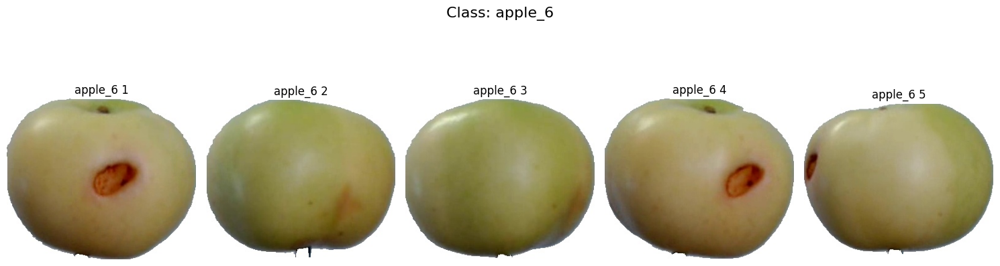

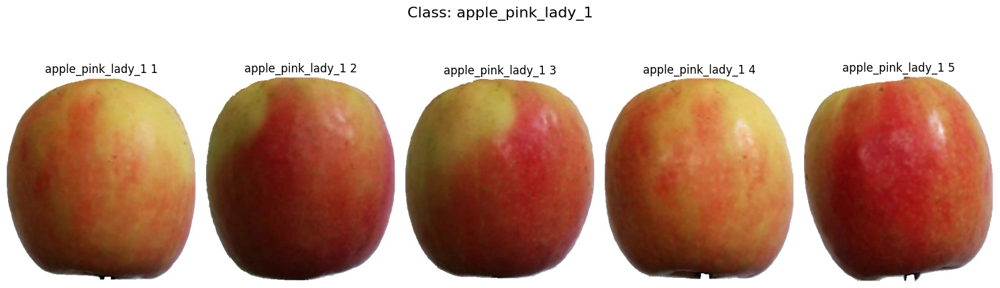

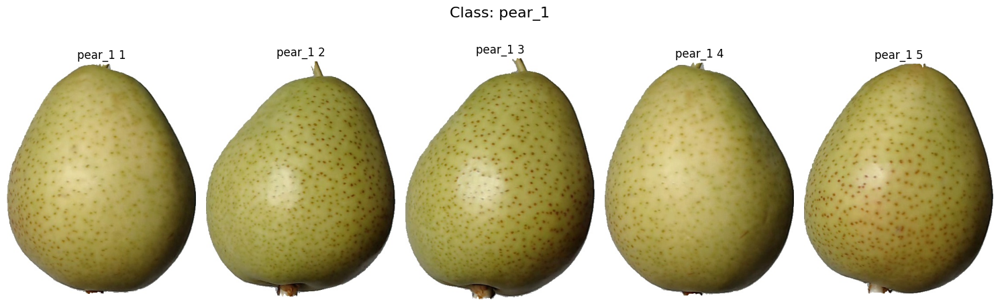

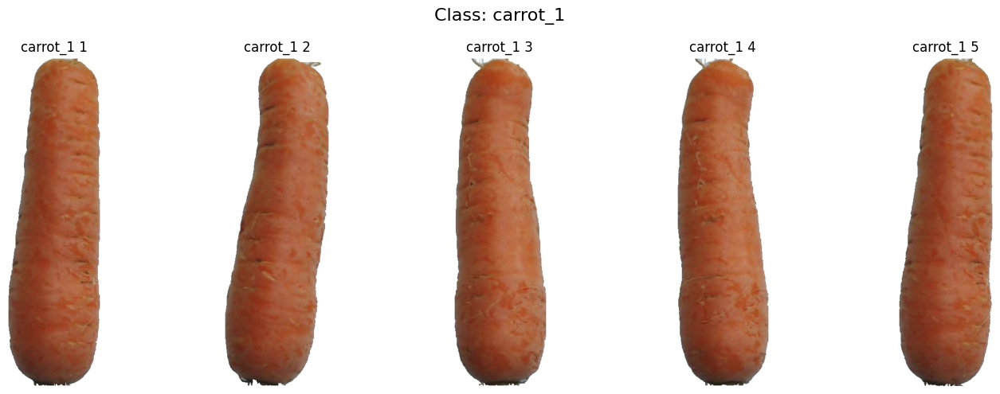

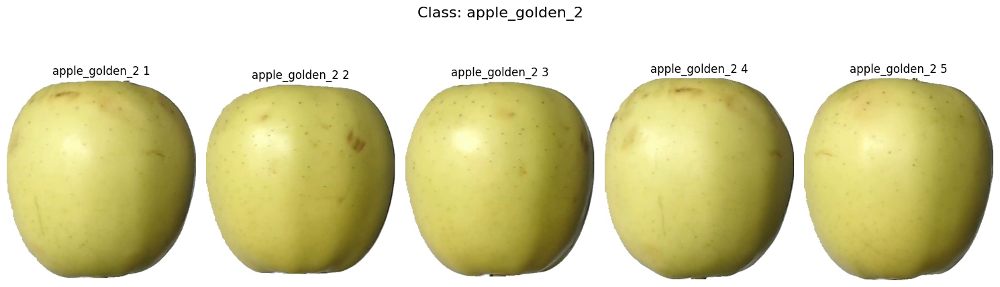

...

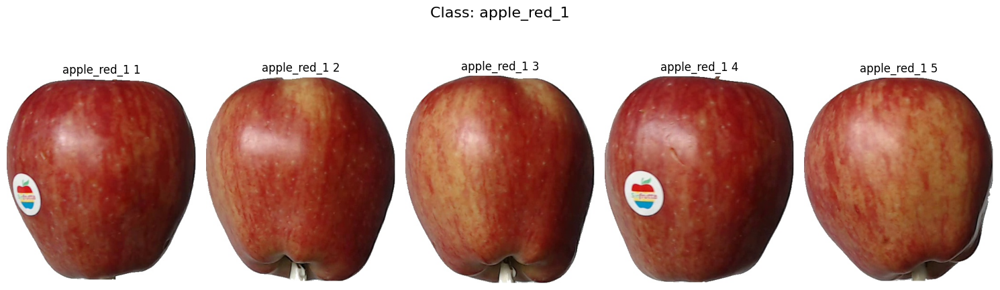

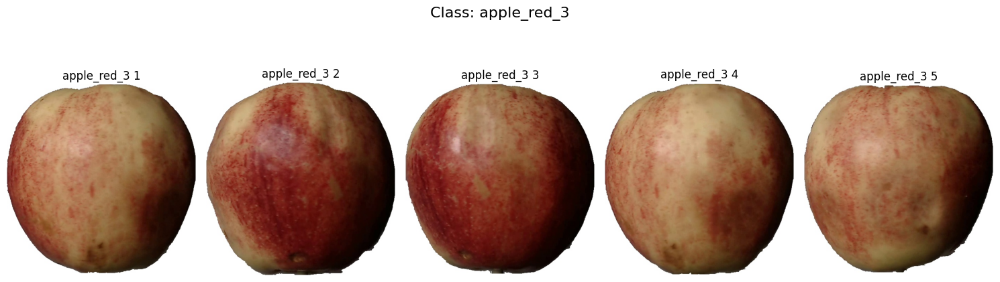

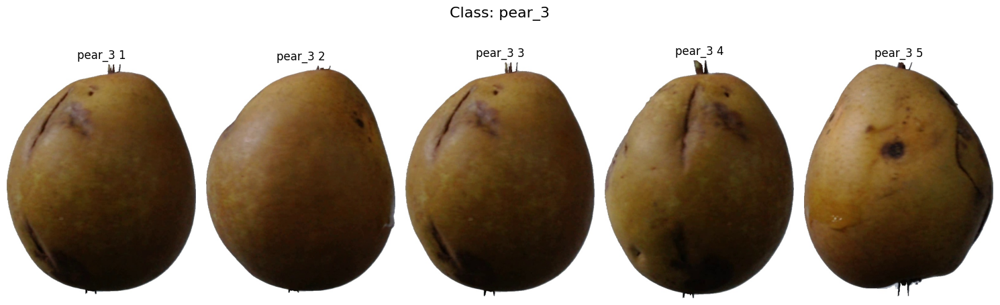

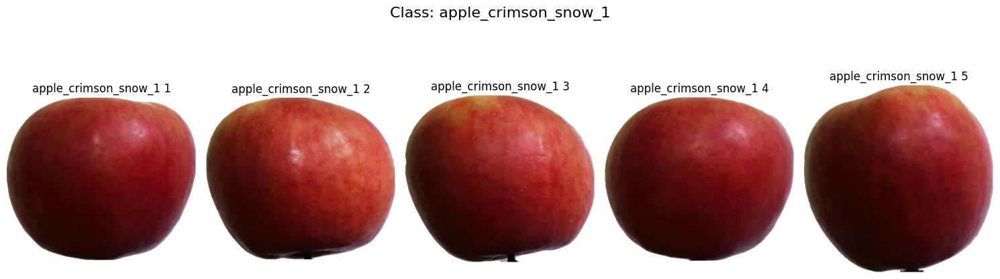

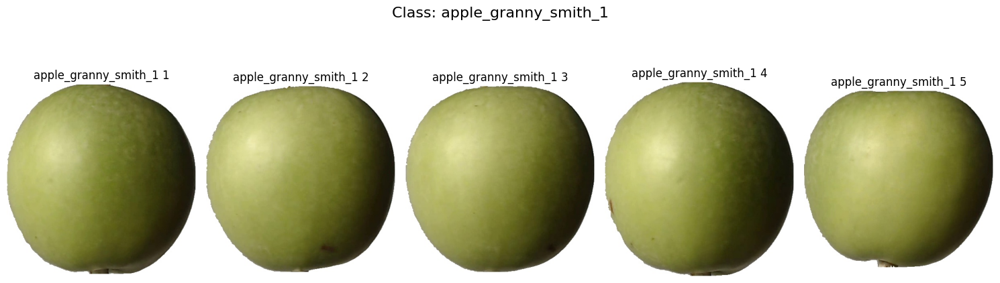

In [13]:
import os
from PIL import Image
import matplotlib.pyplot as plt

# Path to the Test folder
test_folder = '/content/fruits-360-original-size/Test'

# List all class folders in the Test directory
class_folders = [f for f in os.listdir(test_folder) if os.path.isdir(os.path.join(test_folder, f))]

# Display a few images from each class
for class_folder in class_folders:
    class_path = os.path.join(test_folder, class_folder)

    # List images in the class folder
    images = os.listdir(class_path)

    # Display up to 5 images from the class
    plt.figure(figsize=(15, 5))  # Adjust figure size
    for i, image_name in enumerate(images[:5]):  # Adjust to show desired number of images per class
        image_path = os.path.join(class_path, image_name)

        # Load the image
        image = Image.open(image_path)

        # Plot the image
        plt.subplot(1, 5, i + 1)  # Create a grid of 1 row and 5 columns
        plt.imshow(image)
        plt.axis('off')  # Hide axes
        plt.title(f"{class_folder} {i+1}")

    plt.suptitle(f"Class: {class_folder}", fontsize=16)  # Title for the entire class
    plt.tight_layout()  # Adjust layout
    plt.show()


In [14]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Set the path to the training and testing folders
train_dir = '/content/fruits-360-original-size/Training'
test_dir = '/content/fruits-360-original-size/Test'

# Initialize ImageDataGenerator for loading and augmenting the images
train_datagen = ImageDataGenerator(rescale=1./255)  # Normalize pixel values to [0, 1]
test_datagen = ImageDataGenerator(rescale=1./255)

# Flow images in batches from directories
train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(100, 100),  # Resize images
    batch_size=32,
    class_mode='categorical'  # For multi-class classification
)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(100, 100),
    batch_size=32,
    class_mode='categorical'
)


Found 6231 images belonging to 24 classes.
Found 3110 images belonging to 24 classes.


In [15]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout

# Define the model
model = Sequential([
    # Convolutional layers
    Conv2D(32, (3, 3), activation='relu', input_shape=(100, 100, 3)),
    MaxPooling2D((2, 2)),
    Conv2D(64, (3, 3), activation='relu'),
    MaxPooling2D((2, 2)),
    Conv2D(128, (3, 3), activation='relu'),
    MaxPooling2D((2, 2)),

    # Flatten and fully connected layers
    Flatten(),
    Dense(128, activation='relu'),
    Dropout(0.5),  # Regularization
    Dense(train_generator.num_classes, activation='softmax')  # Output layer
])

# Compile the model
model.compile(optimizer='adam',
              loss='categorical_crossentropy',
              metrics=['accuracy'])


/usr/local/lib/python3.10/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


In [17]:
# Train the model
history = model.fit(
    train_generator,
    epochs=10,  # Adjust the number of epochs as needed
    validation_data=test_generator
)


Epoch 1/10


/usr/local/lib/python3.10/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


195/195 ━━━━━━━━━━━━━━━━━━━━ 159s 797ms/step - accuracy: 0.4185 - loss: 1.9007 - val_accuracy: 0.9781 - val_loss: 0.0997
Epoch 2/10
195/195 ━━━━━━━━━━━━━━━━━━━━ 199s 789ms/step - accuracy: 0.9067 - loss: 0.2742 - val_accuracy: 0.9630 - val_loss: 0.0775
Epoch 3/10
195/195 ━━━━━━━━━━━━━━━━━━━━ 157s 801ms/step - accuracy: 0.9333 - loss: 0.1895 - val_accuracy: 0.9923 - val_loss: 0.0166
Epoch 4/10
195/195 ━━━━━━━━━━━━━━━━━━━━ 152s 777ms/step - accuracy: 0.9638 - loss: 0.1013 - val_accuracy: 1.0000 - val_loss: 0.0019
Epoch 5/10
195/195 ━━━━━━━━━━━━━━━━━━━━ 150s 765ms/step - accuracy: 0.9743 - loss: 0.0675 - val_accuracy: 0.9981 - val_loss: 0.0059
Epoch 6/10
195/195 ━━━━━━━━━━━━━━━━━━━━ 152s 778ms/step - accuracy: 0.9719 - loss: 0.0753 - val_accuracy: 1.0000 - val_loss: 0.0021
Epoch 7/10
195/195 ━━━━━━━━━━━━━━━━━━━━ 156s 799ms/step - accuracy: 0.9806 - loss: 0.0574 - val_accuracy: 0.9907 - val_loss: 0.0169
Epoch 8/10
195/195 ━━━━━━━━━━━━━━━━━━━━ 172s 880ms/step - accuracy: 0.9711 - loss: 0.08

In [18]:
# Evaluate on the test data
test_loss, test_accuracy = model.evaluate(test_generator)
print(f"Test Accuracy: {test_accuracy * 100:.2f}%")


98/98 ━━━━━━━━━━━━━━━━━━━━ 22s 220ms/step - accuracy: 0.9983 - loss: 0.0050
Test Accuracy: 99.84%


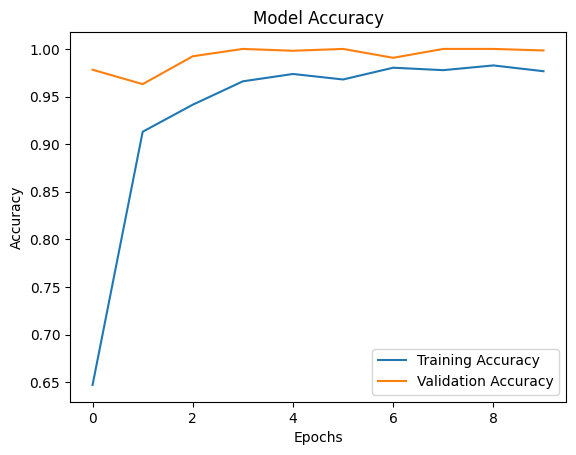

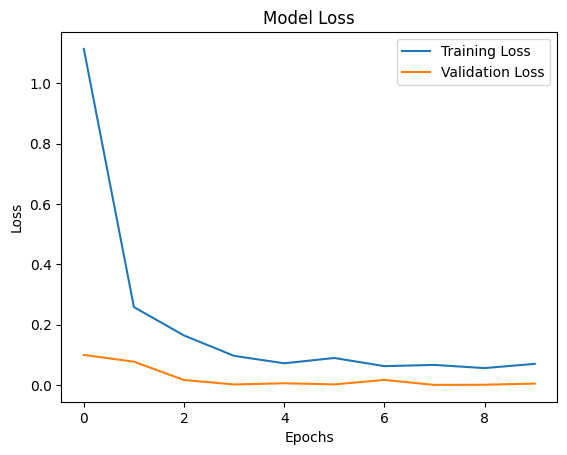

In [19]:
import matplotlib.pyplot as plt

# Plot training and validation accuracy
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Model Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

# Plot training and validation loss
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Model Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()


In [20]:
# Save the model
model.save('fruit_classifier_model.h5')


In [21]:
# Save the model in Keras native format
model.save('fruit_classifier_model.keras')


In [22]:
from tensorflow.keras.models import load_model

# Load the model
model = load_model('fruit_classifier_model.keras')


/usr/local/lib/python3.10/dist-packages/keras/src/saving/saving_lib.py:713: UserWarning: Skipping variable loading for optimizer 'rmsprop', because it has 12 variables whereas the saved optimizer has 22 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


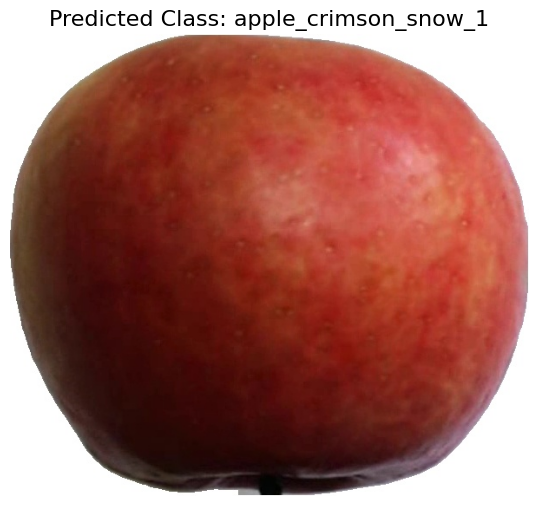

Predicted Class: apple_crimson_snow_1


In [26]:
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.image import load_img, img_to_array
import numpy as np
from tensorflow.keras.models import load_model

# Load the trained model
model = load_model('fruit_classifier_model.keras')  # Update the path to your model if needed

# Path to the uploaded image
uploaded_image_path = '/content/fruits-360-original-size/Test/apple_crimson_snow_1/r0_103.jpg'

# Load and preprocess the image
image = load_img(uploaded_image_path, target_size=(100, 100))  # Resize to match model input
image_array = img_to_array(image)  # Convert to array
image_array = image_array / 255.0  # Normalize pixel values to [0, 1]
image_array = np.expand_dims(image_array, axis=0)  # Add batch dimension

# Make a prediction
predictions = model.predict(image_array)

# Get the class with the highest probability
predicted_class = np.argmax(predictions, axis=1)[0]

# Map class indices to class labels (from your training generator)
class_indices = train_generator.class_indices  # Ensure this dictionary is available
class_labels = {v: k for k, v in class_indices.items()}  # Reverse dictionary

# Get the predicted class label
predicted_label = class_labels[predicted_class]

# Display the input image and predicted label
plt.figure(figsize=(8, 6))
plt.imshow(load_img(uploaded_image_path))  # Display the input image
plt.axis('off')
plt.title(f"Predicted Class: {predicted_label}", fontsize=16)
plt.show()

print(f"Predicted Class: {predicted_label}")

